## Project 5 Diffusion

Due Wed Nov 27, 9am




Edit this cell to include the names and descriptions of the contributions of anybody __other than yourself__ who contributed to this work.


In [1]:
%load_ext pycodestyle_magic

ModuleNotFoundError: No module named 'pycodestyle_magic'

In [2]:
"""
Author:      Connor Quigg
Created:     November 18th, 2019
Description: This program was created for the final project in Physics 210
             at the University of British Columbia.  The objective is to
             model the 2D diffusion equation using the method of finite
             differences.  We wish to model the diffusion of a drop of dye
             over a square dish of side length L containing a thin layer of
             water.  This program will produce a simulation of the system
             at 0.1s intervals over 100 seconds.  For 0.01 < t < 10, we
             fit 30 evenly-spaced Y-midplane values to a Gaussian curve and
             store the standard deviations of each fit.  In later cells,
             we plot the standard deviation vs. sqrt(time) and compare with
             the theoretical expectation, as well as plot the concentration
             integrals corresponding to each animation frame over time.
             Project extensions include displaying the initial and final
             concentration integrals and their percent difference to the
             screen, and plotting the initial and an intermediate
             diffusion state in 3D.
"""

# Main code and animation
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from scipy.optimize import curve_fit
from IPython.display import HTML
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 100000000


def gauss(x_vals, mu, sigma, A):
    '''
    Purpose: For use in scipy's curve_fit function to fit input
             data to a Gaussian curve.

    Args:
        x_vals: Array containing the independent variable values.
        mu: A number, the average value of the independent variable.
        sigma: A number, the standard deviation of the Gaussian.
        A: A number, the amplitude of the Gaussian.

    Returns: An array of the same shape as x_vals containing the dependent
             variable values in the shape of a Gaussian curve.

    '''
    return A*np.exp(-0.5*(((x_vals - mu) / sigma)**2))/sigma/np.sqrt(2*np.pi)


# constants
L = 1  # size of "box"
D = 0.001
N = 100  # number of grid points in 1D
dt = 0.01
dx = L/N  # is the same as dy
tmax = 100
steps = int(tmax//dt)+1

# prepare for fitting Y midplane data for t between 0.01 and 10
# and storing the standard deviation of each fit
# for the plotting later, we need samples spaced evenly over sqrt(t)
# but in order for plotsteps to be compatible with the main calculations,
# we square the interval values:
plotsteps = np.linspace(np.sqrt(0.01), np.sqrt(10), 30)**2
plotsteps /= dt
plotsteps = plotsteps.astype(int)
sigmas = np.zeros(len(plotsteps))
x = np.linspace(0, L, N)
guesses = np.array([0.5, 0.2, 0.008])

# for adding sigma values to sigmas:
sig_count = 0

# initial condition:
C = np.zeros((N, N))
C[N//2, N//2] = 10

# total diffusion coefficent:
k = dt*D/dx/dx

# 2D array for updating calculations:
Cp = np.zeros((N, N))

# set up animation requirements, establish an iterable
# over which we store animation frames and grid sums
fig = plt.figure()
ims = []
animate = np.arange(0, tmax, 0.1)
animate /= dt
animate = animate.astype(int)
sums = np.zeros(len(animate))
# for adding sum values to sums:
sum_count = 0


for n in range(steps):
    # do all the points, except the boundaries
    Cp[1:-1, 1:-1] = (C[1:-1, 1:-1] + k *
                      ((C[1:-1, 2:] + C[1:-1, :-2] - 2*C[1:-1, 1:-1]) +
                       (C[2:, 1:-1] + C[:-2, 1:-1] - 2*C[1:-1, 1:-1])))
    # and the boundaries:
    Cp[:, 0] = Cp[:, 1]
    Cp[:, -1] = Cp[:, -2]
    Cp[0, :] = Cp[1, :]
    Cp[-1, :] = Cp[-2, :]

    # reset C as Cp
    C, Cp = Cp, C

    # accumulate standard deviations in 'sigmas':
    if n in plotsteps:
        Cy_mid = C[:, N//2]
        # fit the data:
        fit_params, fit_cov = curve_fit(gauss, x, Cy_mid, p0=guesses)
        sigmas[sig_count] = fit_params[1]
        sig_count += 1

    # accumulate animation frames and grid sums:
    if n in animate:
        ims.append((plt.pcolormesh(C.copy(), vmin=0), ))
        sums[sum_count] = np.sum(C)
        sum_count += 1

    # save two intermediate steps for use in 3D plot extension
    if n == 600:
        Cj = np.copy(C)
    if n == 3000:
        Ck = np.copy(C)

# display animation:
iman = animation.ArtistAnimation(fig, ims, interval=15, repeat=False)
plt.close()
HTML(iman.to_jshtml())

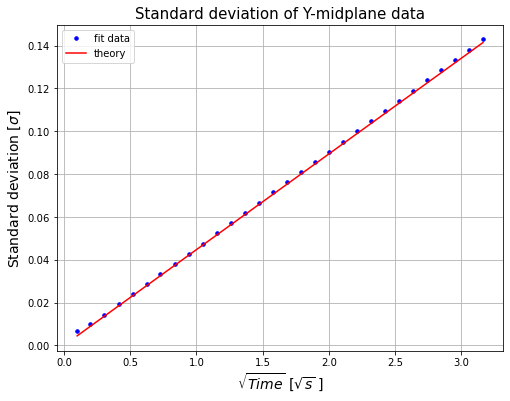

In [4]:
# plot of Gaussian width vs sqrt(t)

# sqrt(t)
t_sq = np.sqrt(np.linspace(0.01, 10, 30))

# sqrt of times at which the std deviations were measured
t_sigma = np.sqrt(plotsteps*dt)

# theory function to plot against
theory = np.sqrt(2*D)*t_sq

# plot the two lines
plt.figure(figsize=(8, 6))
plt.plot(t_sigma, sigmas, 'bo', markersize=3.5, label='fit data')
plt.plot(t_sq, theory, 'r-', label='theory')
plt.xlabel(r"$\sqrt{Time}$ [$\sqrt{s}$ ]", fontsize=14)
plt.ylabel(r"Standard deviation [$\sigma$]", fontsize=14)
plt.title("Standard deviation of Y-midplane data", fontsize=15)
plt.legend()
plt.grid()
plt.show()

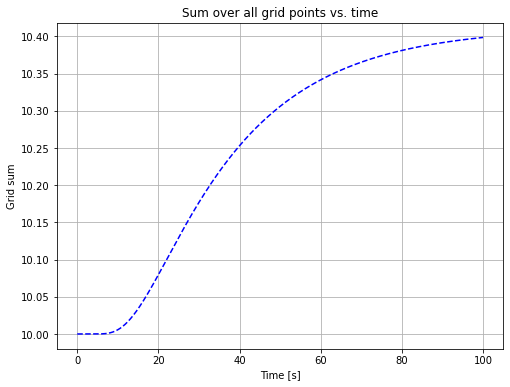

In [7]:
# plot sum of all grid points over time

t = animate*dt
fig = plt.figure(figsize=(8, 6))
plt.plot(t, sums, 'b--')
plt.title("Sum over all grid points vs. time")
plt.xlabel("Time [s]")
plt.ylabel("Grid sum")
plt.grid()
plt.show()

In [ ]:
# # ****copy of program to experiment with varying values of dt****
# #  this cell is not marked, will be completely commented out in final version
# #  here we take tmax=10 for testing

# # constants
# L = 1  # size of "box"
# D = 0.001
# N = 50  # number of grid points in 1D
# dt = .096
# dx = L/N  # is the same as dy
# tmax = 10
# steps = int(tmax//dt)+1

# # prepare for fitting Y midplane data for t between 0.01 and 10
# # and storing the standard deviation of each fit
# # for the plotting later, we need samples spaced evenly over sqrt(t)
# # but in order for plotsteps to be compatible with the main calculations,
# # we square the interval values:
# plotsteps = np.linspace(np.sqrt(0.01), np.sqrt(10), 30)**2
# plotsteps /= dt
# plotsteps = plotsteps.astype(int)
# sigmas = np.zeros(len(plotsteps))
# x = np.linspace(0, L, N)
# guesses = np.array([0.5, 0.2, 0.008])
# # for adding sigma values to sigmas:
# sig_count = 0

# # initial condition:
# C = np.zeros((N, N))
# C[N//2, N//2] = 10

# # total diffusion coefficent:
# k = dt*D/dx/dx

# # 2D array for updating calculations:
# Cp = np.zeros((N, N))

# # set up animation requirements, establish an iterable
# # over which we store animation frames and grid sums
# fig = plt.figure()
# ims = []
# animate = np.arange(0, tmax, 0.1)
# animate /= dt
# animate = animate.astype(int)
# sums = np.zeros(len(animate))
# # for adding sum values to sums:
# sum_count = 0


# for n in range(steps):
#     # do all the points, except the boundaries
#     Cp[1:-1, 1:-1] = (C[1:-1, 1:-1] + k *
#                       ((C[1:-1, 2:] + C[1:-1, :-2] - 2*C[1:-1, 1:-1]) +
#                         (C[2:, 1:-1] + C[:-2, 1:-1] - 2*C[1:-1, 1:-1])))
#     # and the boundaries:
#     Cp[:, 0] = Cp[:, 1]
#     Cp[:, -1] = Cp[:, -2]
#     Cp[0, :] = Cp[1, :]
#     Cp[-1, :] = Cp[-2, :]

#     # reset C as Cp
#     C, Cp = Cp, C

#     #accumulate standard deviations in 'sigmas':
# #     if n in plotsteps:
# #         Cy_mid = C[:, N//2]
# #         # fit the data:
# #         fit_params, fit_cov = curve_fit(gauss, x, Cy_mid, p0=guesses)
# #         sigmas[sig_count] = fit_params[1]
# #         sig_count += 1

#     # accumulate animation frames and grid sums:
#     if n in animate:
#         ims.append((plt.pcolormesh(C.copy(), vmin=0), ))
#         sums[sum_count] = np.sum(C)
#         sum_count += 1

# #display animation:
# iman = animation.ArtistAnimation(fig, ims, interval=15, repeat=False)
# plt.close()
# HTML(iman.to_jshtml())

Using the above cell to experiment (we won't actually mark the code that's there)
Answer the following questions in the cell below:

5a) What happens to the animation when dt is too large? 

5b) What is the value of dt where the simulation diverges? 

5c) What is the value of $dt \, D/dx^2$ where the simulation starts to diverge? 

5d) What happens to the sums you generate for question (4) when the simulation diverges?  

5e) If you use a grid of only 50x50 points, where is the threshold for dt to converge now? 

ANSWERS TO THE ABOVE QUESTIONS HERE:

5a) When dt is too large, the animation either does not progress, or only a minimal amount.  Additionally, there is a grid of negative-valued grid points in the solute.  The animation almost appears to be failing to evolve beind an opaque grid.

5b) The grid values become nonsensical, as described above, when dt=0.0249.

5c) When the simulation diverges, i.e. when dt=0.0249, the value of dt*D/dx/dx is 0.249.

5d) Plotting the sums reveals an exponential-like increase in the sums.  Something like sum ~ e^t.  Additionally, the sums appear to be approximately zero until t ~ 6 seconds before exponential behavior is seen.

5e) When we use a 50x50 grid, divergent behavior is first seen when dt=0.096

Initial grid sum: 10.0
Final grid sum: 10.399
Difference between initial and final values: 3.99%


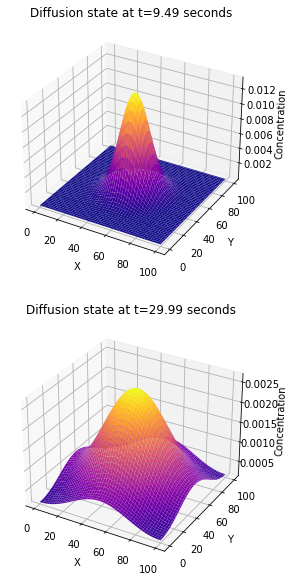

In [11]:
# ===== Project Extensions =====


from mpl_toolkits.mplot3d import Axes3D

# percent difference in sums
percent = abs(sums[0] - sums[-1]) / sums[0] * 100

print('Initial grid sum: {}\nFinal grid sum: {:.3f}'.format(sums[0], sums[-1]))
print('Difference between initial and final values: {:.2f}%'.format(percent))

x3d = np.linspace(0, 100, N)
y3d = np.linspace(0, 100, N)
X, Y = np.meshgrid(x3d, y3d)

Ci = np.zeros((N, N))
Ci[N//2, N//2] = 10
fig = plt.figure(figsize=(10, 10))
# plot initial state in 3D
ax = fig.add_subplot(211, projection='3d')
ax.plot_surface(X, Y, Cj, cmap='plasma', vmin=0)
ax.grid(True)
ax.set_title('Diffusion state at t={:.2f} seconds'.format((949*dt)))
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Concentration')


# plot intermediate state
ax1 = fig.add_subplot(212, projection='3d')
ax1.plot_surface(X, Y, Ck, cmap='plasma', vmin=0)
ax1.grid(True)
ax1.set_title('Diffusion state at t={:.2f} seconds'.format(2999*dt))
ax1.set_xlabel('X')
ax1.set_ylabel('Y')
ax1.set_zlabel('Concentration')
plt.show()

In the cell below describe any new functions/language features you have incorporated, and the details of any extensions to the project you have implemented.
